In [2]:
from IPython.display import Image as Imagepy
from PIL import Image
from PIL import ImageFont
from PIL import ImageDraw 
import speech_recognition as sr
from moviepy.editor import *
from TAMtALUm import * 

Input: martes, jueves 

 MARTES JUEVES

[MoviePy] Building file out.gif with imageio


100%|██████████| 108/108 [00:06<00:00, 15.85it/s]


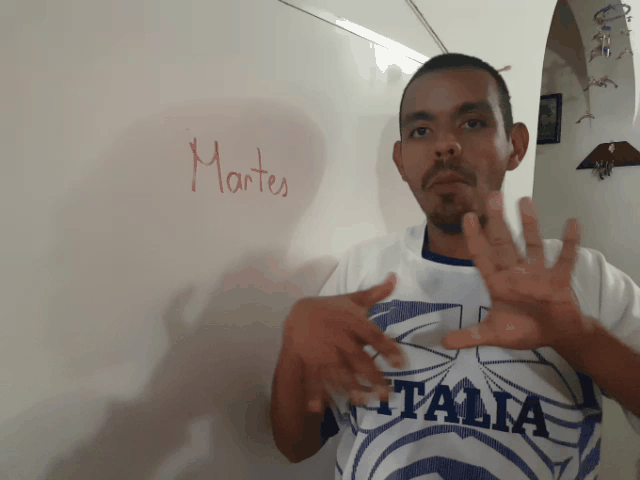

In [3]:
text = ''
f = open ('out.txt','w')
print ('Input:',end=' ')
with open('input.txt') as lineas:    
    for text in lineas:
        print (text,end=' ')
        if text == '':
            break
        lw = tk.tokenize(text.replace('\n',''))
        ls = sp.split(lw)
        ls = morfo.analyze(ls)
        ls = wsd.analyze(ls)
        ls = tagger.analyze(ls)
        ls = sen.analyze(ls);
        out = ProcessSentences(ls,sdb)
        f.write(out)
        f.write('\n')
f.close()
print ('\n')    
input_path =  os.getcwd()
clip = []
print (out)
filenames = listdir(input_path+'/Images/')
for lemmas in out.split():
    spell_flag = False
    letters = ''
    if lemmas.find('-') != -1:
        letters = lemmas.replace('-','')
        spell_flag = True
    lemmas_ = (lemmas)
    lemmas = (lemmas)+'.gif'
    if spell_flag == True:
        for let in letters:
            clip.append((VideoFileClip(input_path+'/Images/'+let+'.gif')))
    else:
        if lemmas in filenames:
                clip.append((VideoFileClip(input_path+'/Images/'+lemmas)))
        else: 
            img = Image.open(input_path+'/Images/default.jpg')
            draw = ImageDraw.Draw(img)
            font = ImageFont.truetype("SSF.ttf", 45)
            draw.text((250,200),lemmas_,(255,255,255),font=font)
            img.save('sample_out.jpg')
            clip.append((VideoFileClip(input_path+'/sample_out.jpg')).set_duration(1))            
if len(clip)>0:
    composition = concatenate_videoclips(clip)
    composition.write_gif('out.gif', fps=10)
    x = Imagepy(filename="out.gif", width=700) 
    display(x)
else:
    print ('No disponible')